In [ ]:
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=100, facecolor='white', frameon=False, fontsize=20, figsize=(12, 12))


In [404]:
adata = sc.read('write/human_no_1914_final.h5ad')

In [405]:
adata.obs

,batch,leiden,louvain
AAACCCAAGATGCTTC-1-1914d_human,1914d_human,11,11
AAACCCAAGTCCTGCG-1-1914d_human,1914d_human,0,7
AAACCCACACCCTGTT-1-1914d_human,1914d_human,6,1
AAACCCACACTTTATC-1-1914d_human,1914d_human,2,3
AAACCCACATAAGCAA-1-1914d_human,1914d_human,10,10
...,...,...,...
TTTGTTGCATCCTTGC-1-1919d_human,1919d_human,9,9
TTTGTTGGTGTAGTGG-1-1919d_human,1919d_human,1,0
TTTGTTGTCCATACTT-1-1919d_human,1919d_human,13,0
TTTGTTGTCCCAAGCG-1-1919d_human,1919d_human,17,16


In [ ]:
sc.pl.umap(adata, color=["EGFR", "PDGFRA", "CDK4"], size = 300, title='')

In [457]:
mes_like = ["ENO2", "HILPDA", "ANXA1", "ANXA2"]

ac_like = ["CST3", "S100B", "MLC1"]

opc_like = ["ALCAM", "OMG", "PLLP"]


endothelial = ["PECAM1"]


stem = ["SOX2","NES"]
stem_other = ["CD44"] 




In [ ]:
sc.pl.umap(adata, color="louvain", size=300, legend_loc="on data")

In [407]:
adata.obs.loc[adata.obs.louvain == '11', 'cell_type_f'] = 'Mesenchymal-like'
adata.obs.loc[adata.obs.louvain == '3', 'cell_type_f'] = 'Mesenchymal-like'
adata.obs.loc[adata.obs.louvain == '2', 'cell_type_f'] = 'Mesenchymal-like'
adata.obs.loc[adata.obs.louvain == '4', 'cell_type_f'] = 'Mesenchymal-like'

adata.obs.loc[adata.obs.louvain == '8', 'cell_type_f'] = 'Astrocyte-like'
adata.obs.loc[adata.obs.louvain == '7', 'cell_type_f'] = 'Astrocyte-like'
adata.obs.loc[adata.obs.louvain == '17', 'cell_type_f'] = 'Astrocyte-like'
adata.obs.loc[adata.obs.louvain == '16', 'cell_type_f'] = 'Astrocyte-like'
adata.obs.loc[adata.obs.louvain == '13', 'cell_type_f'] = 'Astrocyte-like'

adata.obs.loc[adata.obs.louvain == '0', 'cell_type_f'] = 'OPC-like'
adata.obs.loc[adata.obs.louvain == '10', 'cell_type_f'] = 'OPC-like'
adata.obs.loc[adata.obs.louvain == '5', 'cell_type_f'] = 'OPC-like'
adata.obs.loc[adata.obs.louvain == '9', 'cell_type_f'] = 'OPC-like'
adata.obs.loc[adata.obs.louvain == '6', 'cell_type_f'] = 'OPC-like'
adata.obs.loc[adata.obs.louvain == '1', 'cell_type_f'] = 'OPC-like'



adata.obs.loc[adata.obs.louvain == '12', 'cell_type_f'] = 'Stem'
adata.obs.loc[adata.obs.louvain == '14', 'cell_type_f'] = 'Stem'


adata.obs.loc[adata.obs.louvain == '15', 'cell_type_f'] = 'Endothelial-like'



In [ ]:
# add opacity
sc.pl.umap(adata, color="cell_type_f", size=200, alpha=0.7)


<AxesSubplot: title={'center': 'Ours'}>

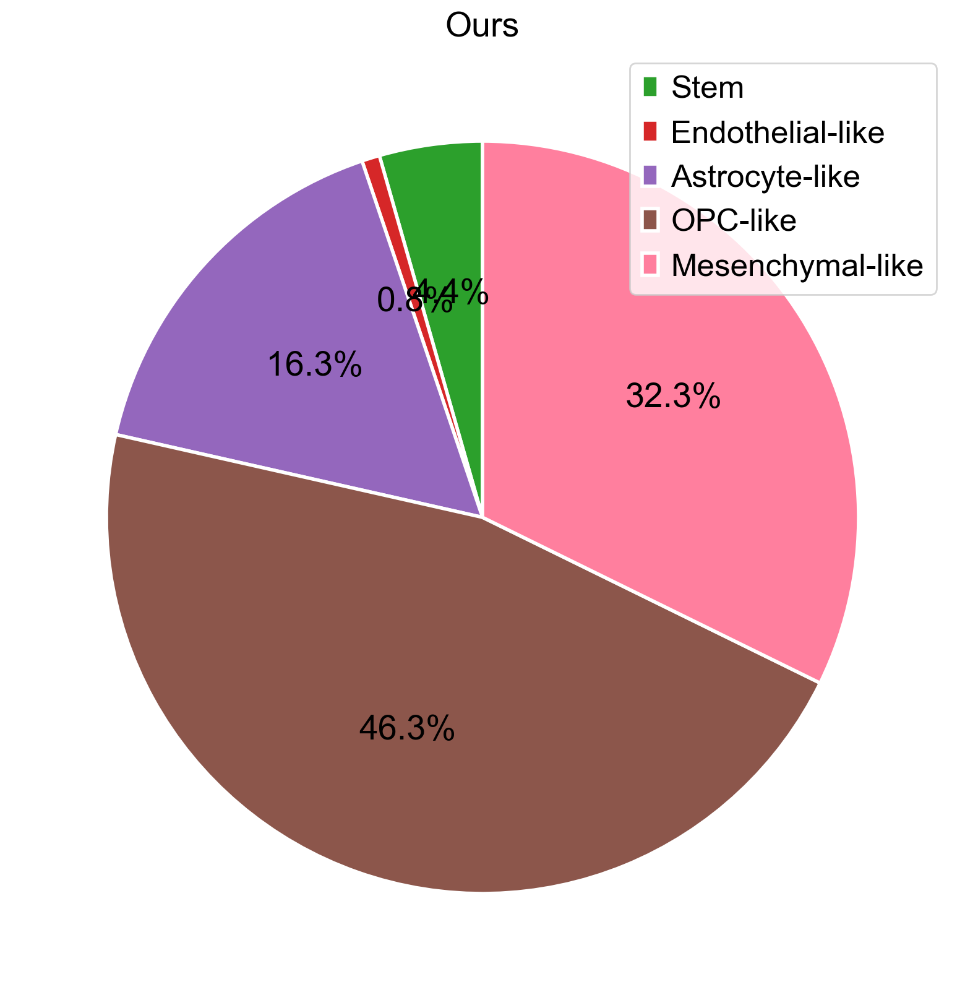

In [534]:

# use the following order and colors:
palette_8 = {
    'Stem': '#2ca02c',
    'Endothelial-like': '#d62728',
    'Astrocyte-like': '#9467bd',
    'OPC-like': '#8c564b',
    'Mesenchymal-like': '#ff7f9e',
}

# make a dataframe of the cell types
cell_type_df = pd.DataFrame(adata.obs['cell_type_f'].value_counts())

# order them to match the palette
cell_type_df = cell_type_df.reindex(palette_8.keys())

# make a pie chart of the cell types, remove the labels from the chart itself, outline black, percentage to 1 decimal place and farther out
cell_type_df.plot.pie(y='cell_type_f', figsize=(20, 10), colors=palette_8.values(), autopct='%1.1f%%', startangle=90, legend=True, fontsize=20, title='Ours', ylabel='', labeldistance=None, wedgeprops=dict(linewidth=2, edgecolor='white'), textprops={'fontsize': 20})


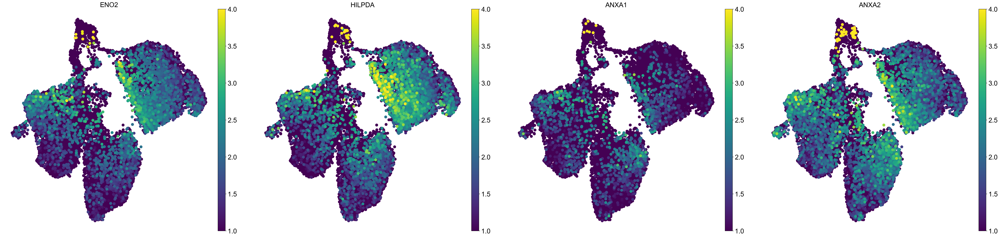

In [408]:
sc.pl.umap(adata, color=mes_like, vmax=4, vmin=1, size=300)
# add up the expression of mes_like genes and put it in adata.var
data = adata[:, mes_like].X.toarray()
mes_expression = np.sum(data, axis=1)
adata.obs = adata.obs.assign(mes_expression=pd.Series(mes_expression, index=adata.obs.index))



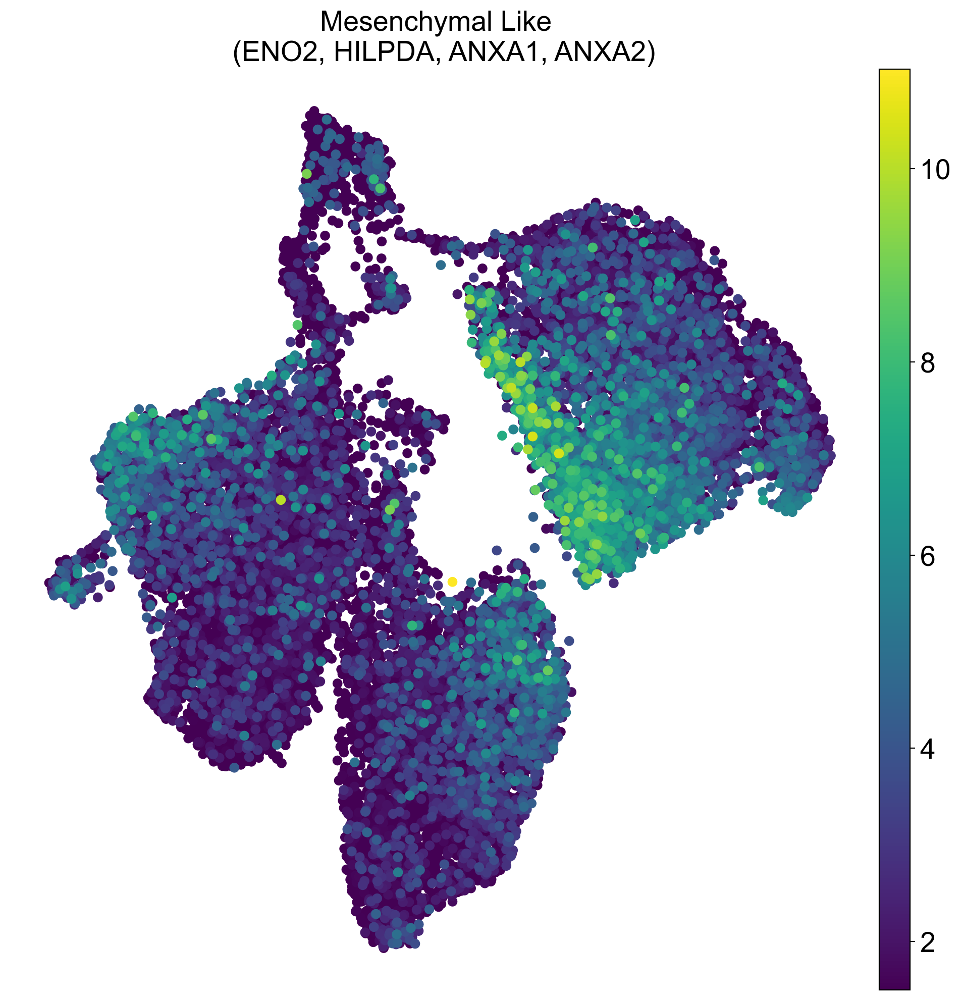

In [414]:
sc.pl.umap(adata, color='mes_expression', vmin=1.5, title='Mesenchymal Like \n (ENO2, HILPDA, ANXA1, ANXA2)', size=200)


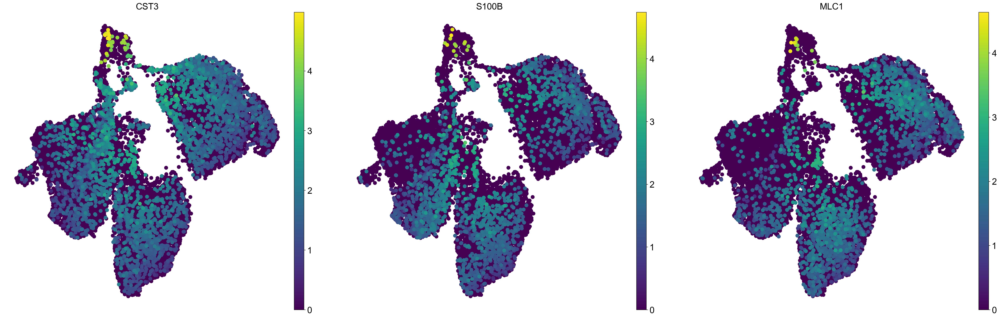

In [415]:
sc.pl.umap(adata, color=ac_like, size=300)
# add up the expression of mes_like genes and put it in adata.var
data = adata[:, ac_like].X.toarray()
ac_expression = np.sum(data, axis=1)
adata.obs = adata.obs.assign(ac_expression=pd.Series(ac_expression, index=adata.obs.index))



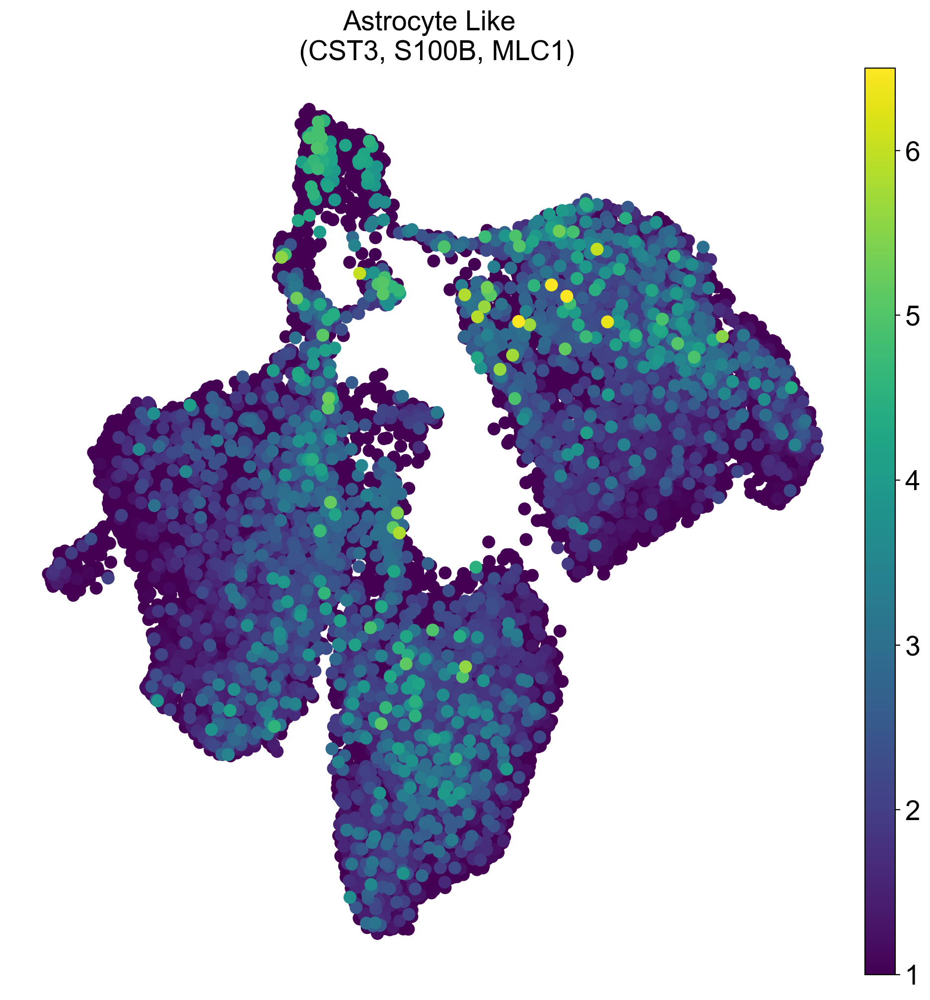

In [423]:
sc.pl.umap(adata, color='ac_expression', vmax=6.5, vmin=1, title='Astrocyte Like \n (CST3, S100B, MLC1)', size=350)

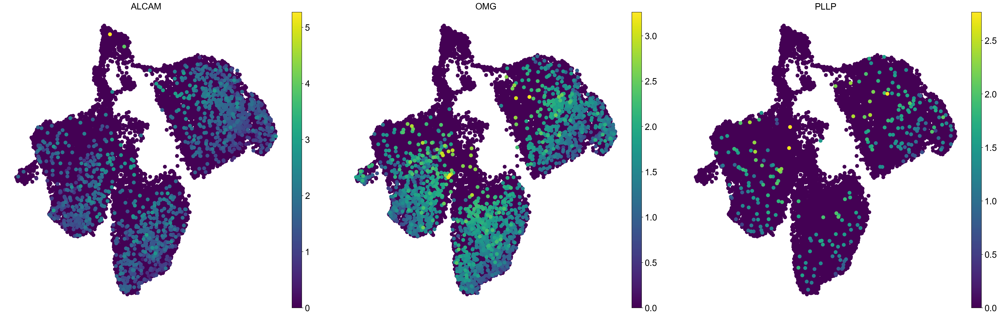

In [424]:
sc.pl.umap(adata, color=opc_like, size=300)
# add up the expression of mes_like genes and put it in adata.var
data = adata[:, opc_like].X.toarray()
opc_expression = np.sum(data, axis=1)
adata.obs = adata.obs.assign(opc_expression=pd.Series(opc_expression, index=adata.obs.index))



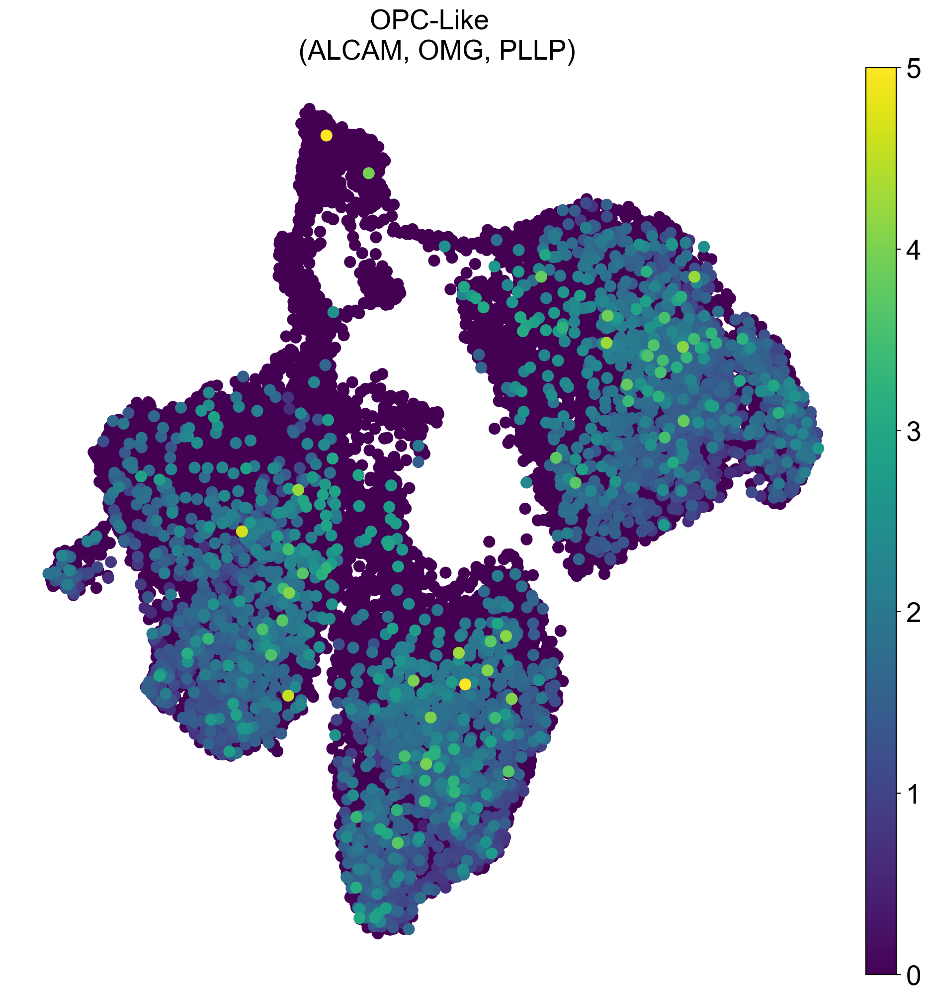

In [437]:
sc.pl.umap(adata, color='opc_expression',vmin=0, vmax=5, title="OPC-Like \n (ALCAM, OMG, PLLP)", size=300)

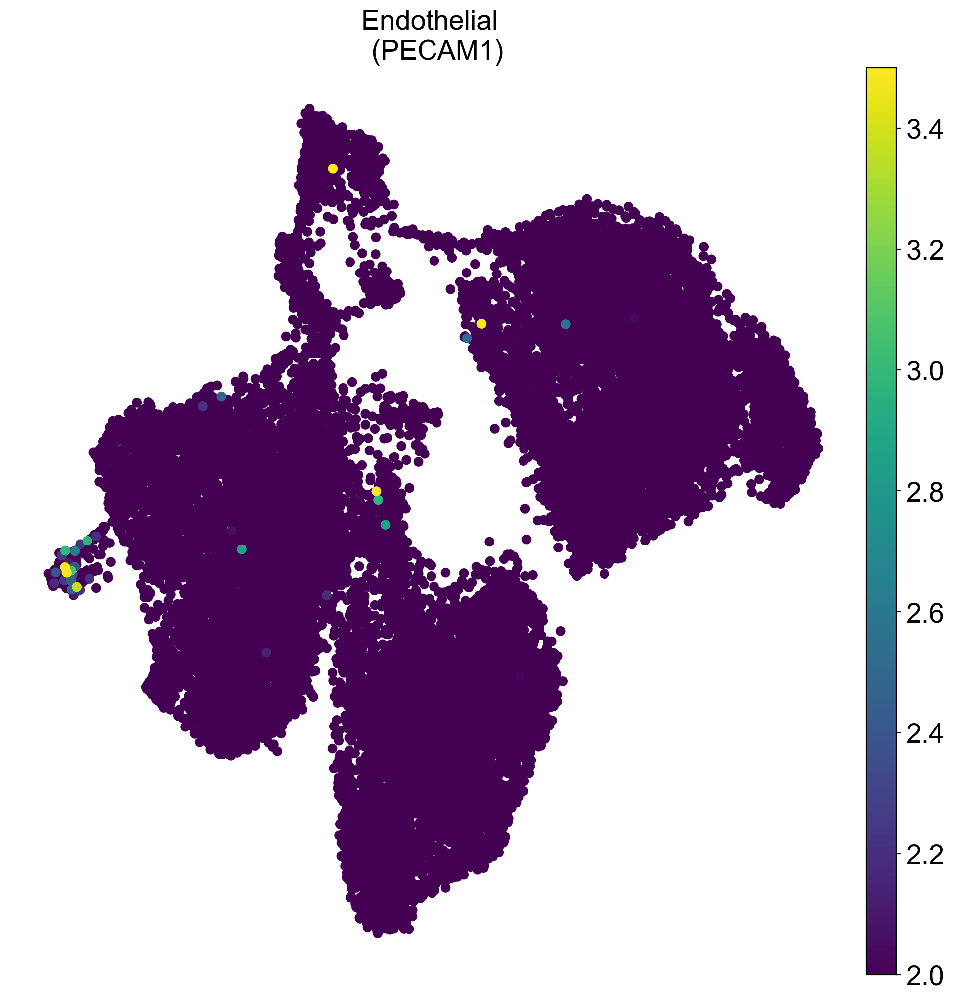

In [449]:
sc.pl.umap(adata, color=endothelial, title="Endothelial \n (PECAM1)", vmin=2, vmax=3.5, size=200)

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])


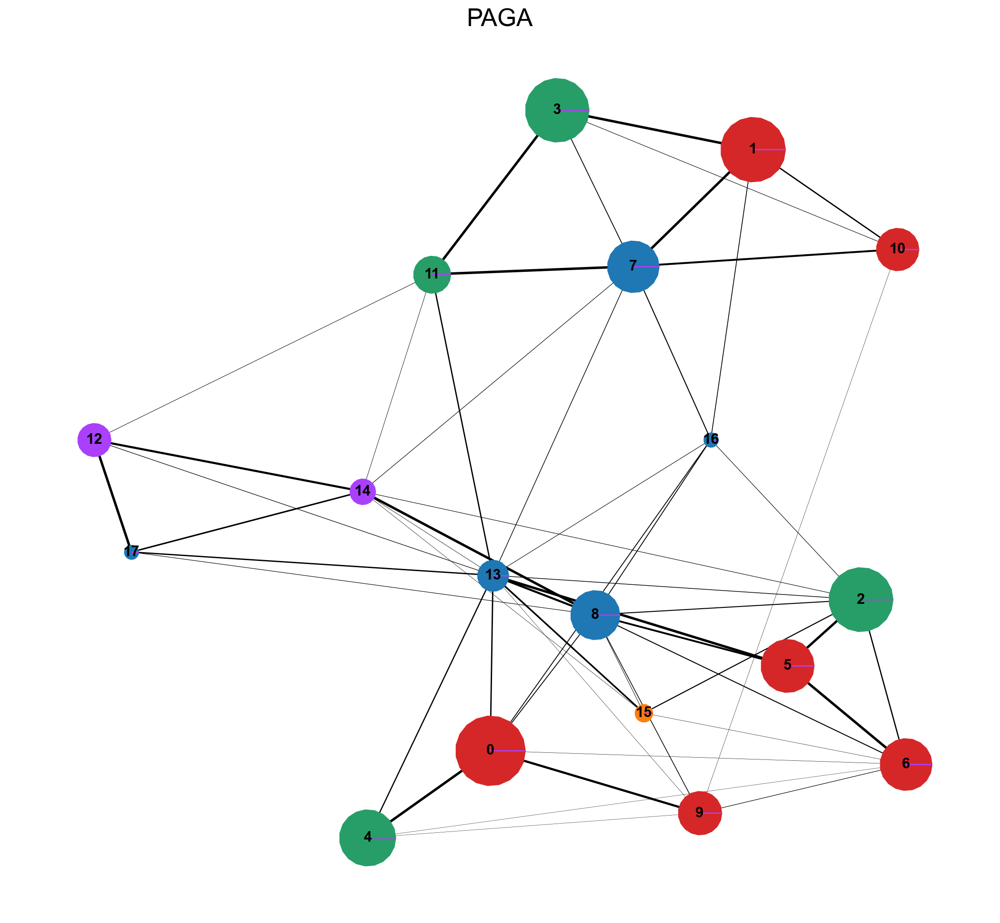

In [531]:
# do paga
sc.tl.paga(adata, groups='louvain')
# include legend with cell_type_f as color
sc.pl.paga(adata, color=['cell_type_f'], title='PAGA', frameon=False, threshold=0.05, fontsize=12, node_size_scale=10, node_size_power=1, edge_width_scale=0.5, min_edge_width=0, max_edge_width=2) 

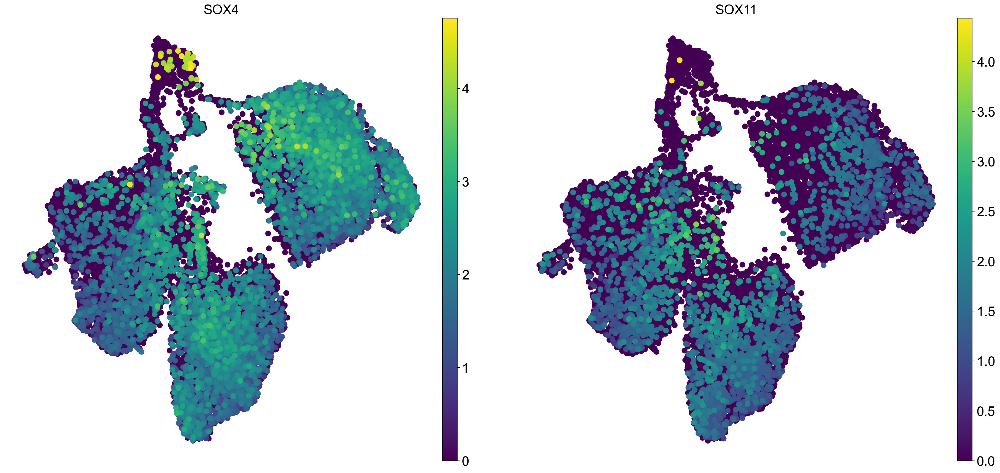

In [458]:
sc.pl.umap(adata, color=npc_like, size=300)

data = adata[:, npc_like].X.toarray()
npc_expression = np.sum(data, axis=1)
adata.obs = adata.obs.assign(npc_expression=pd.Series(npc_expression, index=adata.obs.index))


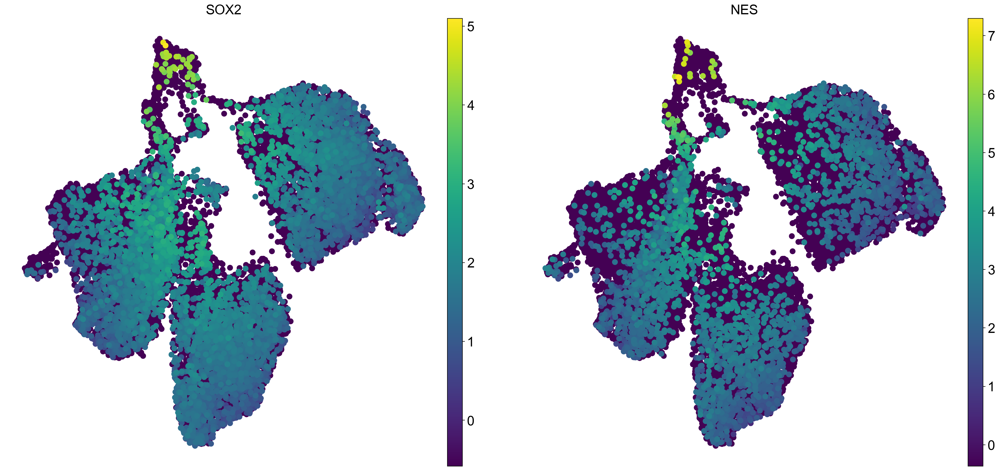

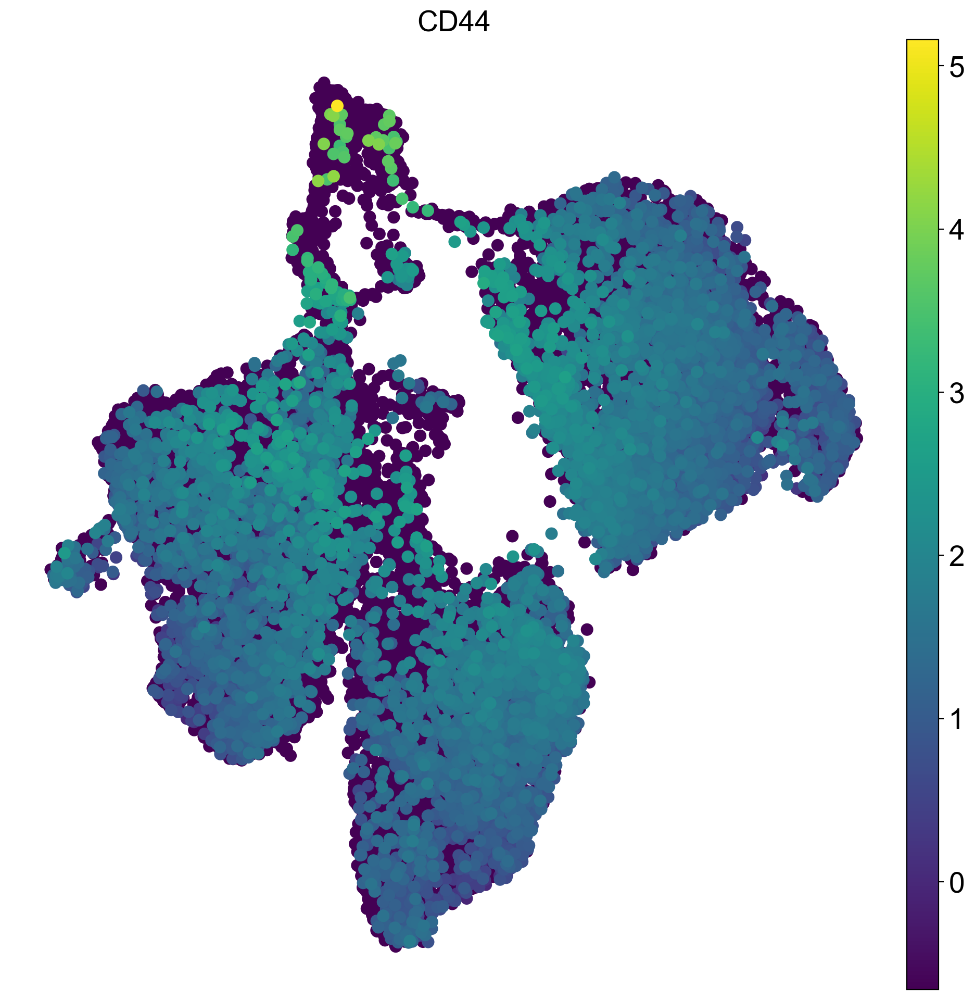

In [532]:
sc.pl.umap(adata, color=stem, size=300)
sc.pl.umap(adata, color=stem_other, size=300)

# add up the expression of mes_like genes and put it in adata.var
data = adata[:, stem].X.toarray()
stem_expression = np.sum(data, axis=1)
adata.obs = adata.obs.assign(stem_expression=pd.Series(stem_expression, index=adata.obs.index))



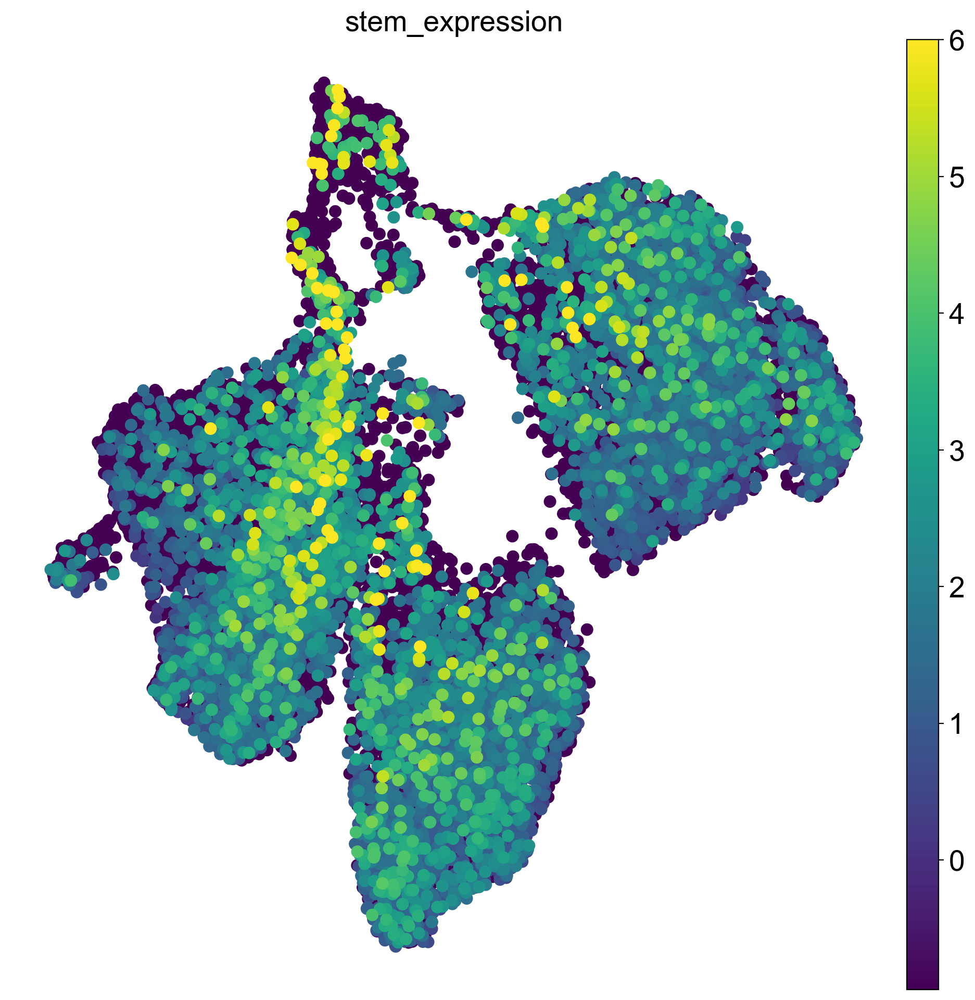

In [533]:
sc.pl.umap(adata, color='stem_expression', vmax=6, size=300)

In [476]:
adata.obs['cell_type_f'].value_counts()

OPC-like            11019
Mesenchymal-like     7682
Astrocyte-like       3876
Stem                 1053
Endothelial-like      183
Name: cell_type_f, dtype: int64

normalizing counts per cell
    finished (0:00:00)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:02:27)


/Users/shaunregenbaum/miniconda3/lib/python3.10/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(


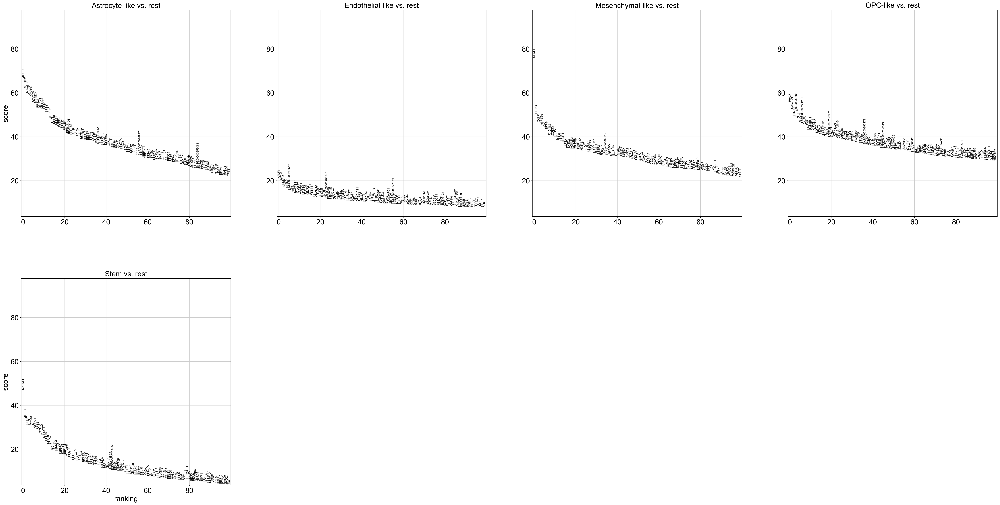

In [459]:
# Get the expression data for differentially expressed genes

sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
# scale each gene to unit variance
sc.pp.scale(adata, max_value=10)


sc.tl.rank_genes_groups(adata, 'cell_type_f', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=100, sharey=True)




In [460]:
# Get the dataframe with the gene rankings
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
top_genes = pd.DataFrame({group: result['names'][group] for group in groups},)




In [461]:
top_genes

,Astrocyte-like,Endothelial-like,Mesenchymal-like,OPC-like,Stem
0,MT-CO3,NALF1,NEAT1,RHOJ,MALAT1
1,MT-CO2,DPYD,PDE10A,SOX2-OT,MT-CO3
2,MT-ATP6,PDE4D,WSB1,RIMS2,RPLP1
3,MT-CO1,VOPP1,KAZN,ENSG00000239381,PTN
4,MT-ND4,MEIS2,SLC2A3,PTPRZ1,RPS18
...,...,...,...,...,...
56031,KAZN,GREB1L,RIMS2,MT-CO3,MSI2
56032,SPAG9,SEC61G-DT,SEC61G-DT,GAPDH,GREB1L
56033,ZFAND3,ENSG00000224271,PTPRZ1,VIM,XIST
56034,RNMT,XIST,RHOJ,NEAT1,FTX


In [462]:

# add all top_genes to a list
top_genes_list = []
for i in range(0, len(top_genes.columns)):
    top_genes_list.append(top_genes.iloc[0:50, i].tolist())


In [463]:
flat_genes = [gene for sublist in top_genes_list for gene in sublist]

adata_subset = adata[:, flat_genes]


In [464]:
print(adata_subset.X.shape)
print(len(adata_subset.var.index))
print(len(adata_subset.obs.index))

(23813, 250)
250
23813


In [465]:

# Create a dataframe with the expression data
df = pd.DataFrame(adata_subset.X.toarray(), index=adata_subset.obs.index)

# add the cell type column by going one by one
df['clusters'] = adata_subset.obs['cell_type_f']

# Calculate mean expression per cluster
mean_expression = df.groupby('clusters').mean()

# Transpose the dataframe
mean_expression_T = mean_expression




In [466]:
mean_expression_T

,0,1,2,3,4,5,6,7,8,9,...,240,241,242,243,244,245,246,247,248,249
clusters,,,,,,,,,,,,,,,,,,,,,
Astrocyte-like,0.666025,0.647988,0.733283,0.618932,0.685751,0.622545,0.813771,0.574473,0.731267,0.726052,...,0.445255,0.813771,0.727756,0.670848,0.494063,0.469009,0.655176,0.436440,0.527308,0.482917
Endothelial-like,-0.419873,-0.324878,-0.166320,-0.241867,-0.282296,-0.217220,-0.254483,-0.581390,-0.292853,-0.227039,...,-0.177352,-0.254483,-0.075605,-0.142456,-0.331709,-0.342086,-0.043821,-0.119718,-0.199266,-0.283519
Mesenchymal-like,-0.169698,-0.156199,-0.242751,-0.135497,-0.103473,-0.111614,-0.181817,-0.093011,-0.191011,-0.134354,...,-0.140248,-0.181817,-0.154711,-0.110273,-0.093608,-0.136625,-0.212835,-0.131472,-0.136050,-0.074622
OPC-like,-0.225314,-0.203240,-0.154295,-0.206283,-0.237023,-0.204012,-0.215615,-0.182255,-0.187451,-0.223405,...,-0.125206,-0.215615,-0.226486,-0.238764,-0.164086,-0.121122,-0.170470,-0.117963,-0.147851,-0.168400
Stem,1.217173,0.937575,0.715313,0.910929,0.760043,0.695341,0.631506,0.572189,0.714214,0.684877,...,0.725241,0.631506,0.833038,0.858430,0.639009,0.597271,0.932541,0.607855,0.633358,0.578301


In [472]:
# hide stem cells cluster
mean_expression_T = mean_expression_T.drop(['Proneural-like'], axis=0)



# reorder to Endothelial, Mesenchymal, OPC-like, Astrocyte-like, Proneural-like
mean_expression_T = mean_expression_T.reindex(['Endothelial-like', 'Mesenchymal-like', 'OPC-like', 'Astrocyte-like'])


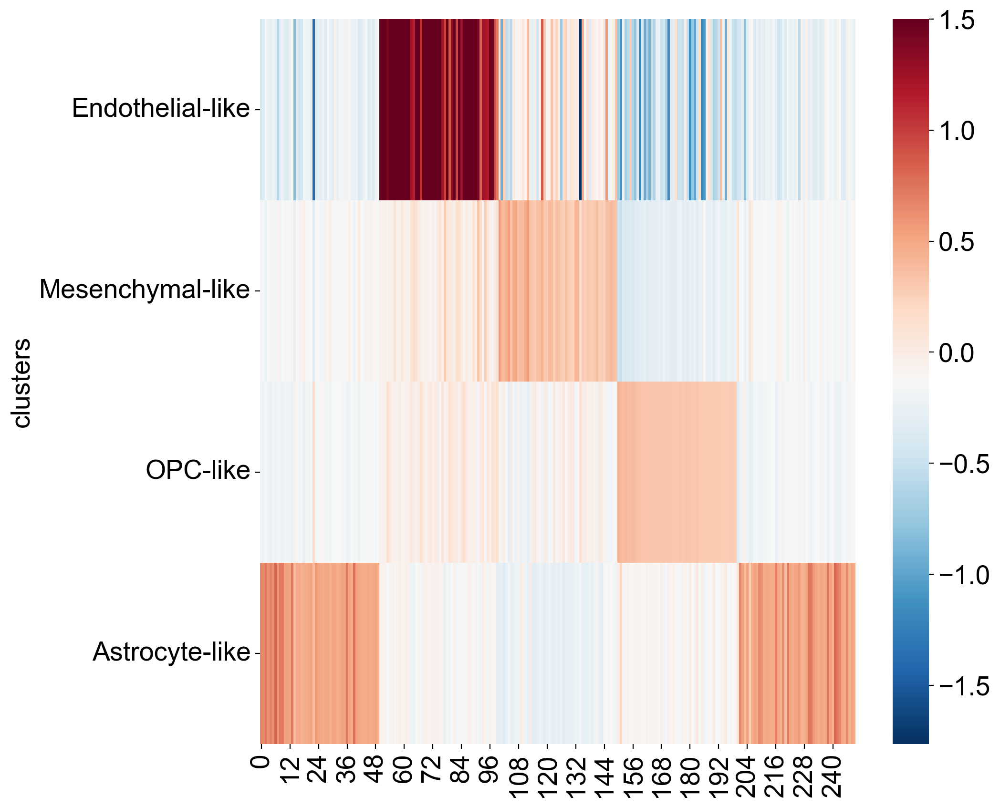

In [479]:
# Generate the heatmap
plt.figure(figsize=(10,10))
# red blue color
sns.heatmap(mean_expression_T, vmax =1.5, cmap='RdBu_r')
plt.show()